## SST and Chlorophylla Anomaly Analysis

In [5]:
from ocean_tools.io.readers import get_xarray_from_file
from ocean_tools.config.defaults import REGIONS
from ocean_tools.processing.data_prep import prepare_dataset_for_analysis, time_aggregator
from ocean_tools.visualization.maps import plot_n_spatial_variable

import warnings
warnings.filterwarnings('ignore')

# Configuración inicial
REGION = REGIONS['cclme']
DATASETS = {
    'sst': "./data/exports/AQUA_MODIS_MONTHLY.2002-08-01_2024-11-01.nc",
    'chlor_a': "./data/exports/AQUA_MODIS_MONTHLY_CHLOR.2002-08-01_2024-11-01.nc"
}

In [6]:
ds_sst_raw = get_xarray_from_file(DATASETS['sst']).sel(time=slice('2002-08-01', '2024-07-01'))
ds_chlor_raw = get_xarray_from_file(DATASETS['chlor_a']).sel(time=slice('2002-08-01', '2024-07-01'))

ds_sst_anom = prepare_dataset_for_analysis(ds_sst_raw.copy(), 'sst', use_anomalies=True)
ds_sst_anom_pos = prepare_dataset_for_analysis(ds_sst_raw.copy(), 'sst', use_anomalies=True, anomaly_transform='positive')
ds_sst_anom_neg = prepare_dataset_for_analysis(ds_sst_raw.copy(), 'sst', use_anomalies=True, anomaly_transform='negative')
ds_sst_anom_abs = prepare_dataset_for_analysis(ds_sst_raw.copy(), 'sst', use_anomalies=True, anomaly_transform='abs')
ds_sst_anom_sqrd = prepare_dataset_for_analysis(ds_sst_raw.copy(), 'sst', use_anomalies=True, anomaly_transform='square')

ds_chlor_anom = prepare_dataset_for_analysis(ds_chlor_raw.copy(), 'chlor_a', use_anomalies=True)
ds_chlor_anom_pos = prepare_dataset_for_analysis(ds_chlor_raw.copy(), 'chlor_a', use_anomalies=True, anomaly_transform='positive')
ds_chlor_anom_neg = prepare_dataset_for_analysis(ds_chlor_raw.copy(), 'chlor_a', use_anomalies=True, anomaly_transform='negative')
ds_chlor_anom_abs = prepare_dataset_for_analysis(ds_chlor_raw.copy(), 'chlor_a', use_anomalies=True, anomaly_transform='abs')
ds_chlor_anom_sqrd = prepare_dataset_for_analysis(ds_chlor_raw.copy(), 'chlor_a', use_anomalies=True, anomaly_transform='square')

### General Focus - Raw, Positive, Negative, Absolute, Squared Anomalies

#### Different Anomaly Means

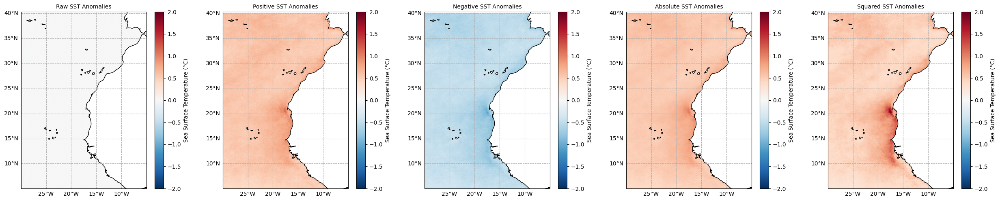

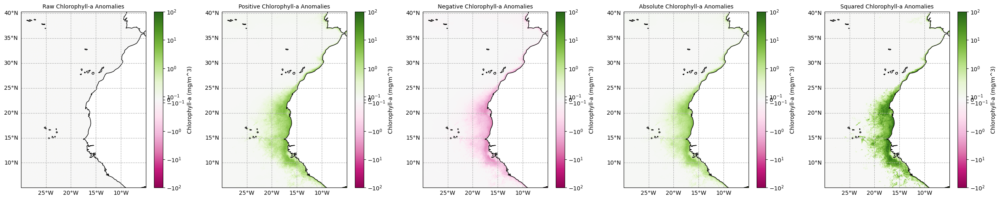

In [59]:
sst_anom_time_mean = ds_sst_anom['sst'].mean(axis=0)
sst_anom_pos_time_mean = ds_sst_anom_pos['sst'].mean(axis=0)
sst_anom_neg_time_mean = ds_sst_anom_neg['sst'].mean(axis=0)
sst_anom_abs_time_mean = ds_sst_anom_abs['sst'].mean(axis=0)
sst_anom_sqrd_time_mean = ds_sst_anom_sqrd['sst'].mean(axis=0)
plot_n_spatial_variable(
    target_list=[sst_anom_time_mean, sst_anom_pos_time_mean, sst_anom_neg_time_mean, sst_anom_abs_time_mean, sst_anom_sqrd_time_mean],
    lat=ds_sst_raw['lat'],
    lon=ds_sst_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=5,
    clim=[-2, 2], 
    cmap='RdBu_r',
    plot_label='Sea Surface Temperature (°C)',
    titles=['Raw SST Anomalies', 'Positive SST Anomalies', 'Negative SST Anomalies', 'Absolute SST Anomalies', 'Squared SST Anomalies']
)

chlor_anom_time_mean = ds_chlor_anom['chlor_a'].mean(axis=0)
chlor_anom_pos_time_mean = ds_chlor_anom_pos['chlor_a'].mean(axis=0)
chlor_anom_neg_time_mean = ds_chlor_anom_neg['chlor_a'].mean(axis=0)
chlor_anom_abs_time_mean = ds_chlor_anom_abs['chlor_a'].mean(axis=0)
chlor_anom_sqrd_time_mean = ds_chlor_anom_sqrd['chlor_a'].mean(axis=0)
plot_n_spatial_variable(
    target_list=[chlor_anom_time_mean, chlor_anom_pos_time_mean, chlor_anom_neg_time_mean, chlor_anom_abs_time_mean, chlor_anom_sqrd_time_mean],
    lat=ds_chlor_raw['lat'],
    lon=ds_chlor_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=5,
    clim=[-100, 100],
    plot_label='Chlorophyll-a (mg/m^3)',
    cmap='PiYG',
    norm_mode='symlog',
    titles=['Raw Chlorophyll-a Anomalies', 'Positive Chlorophyll-a Anomalies', 'Negative Chlorophyll-a Anomalies', 'Absolute Chlorophyll-a Anomalies', 'Squared Chlorophyll-a Anomalies']
)

#### Seasonal Positive vs Negative Anomaly Means

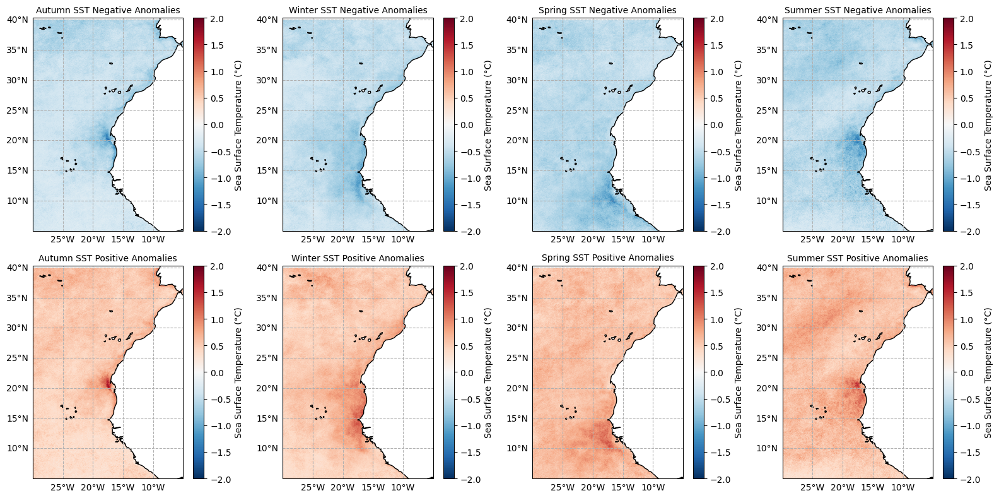

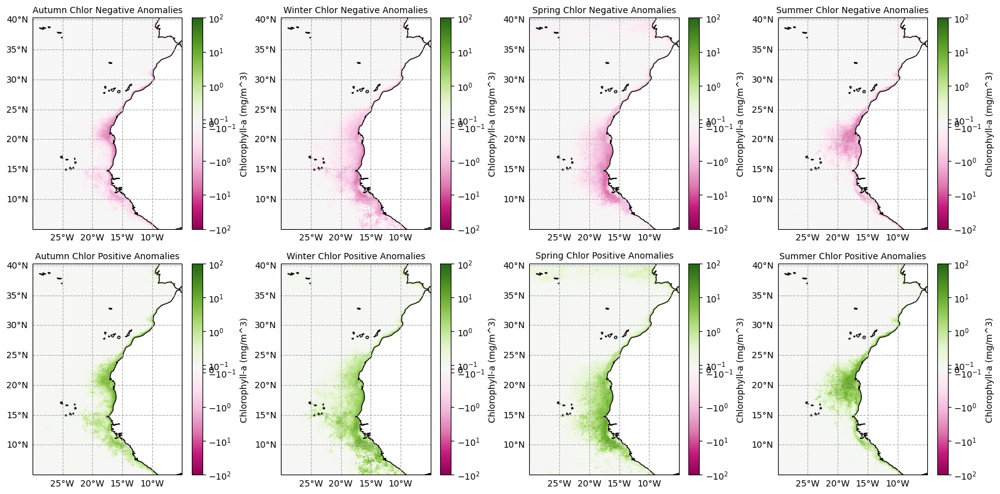

In [13]:
sst_neg_anom_seasonal_means = time_aggregator(ds_sst_anom_neg, 'sst', 'seasonal', 'mean')
sst_pos_anom_seasonal_means = time_aggregator(ds_sst_anom_pos, 'sst', 'seasonal', 'mean')
plot_n_spatial_variable(
    [
        sst_neg_anom_seasonal_means['autumn'], sst_neg_anom_seasonal_means['winter'], sst_neg_anom_seasonal_means['spring'], sst_neg_anom_seasonal_means['summer'],
        sst_pos_anom_seasonal_means['autumn'], sst_pos_anom_seasonal_means['winter'], sst_pos_anom_seasonal_means['spring'], sst_pos_anom_seasonal_means['summer']
    ],
    ds_sst_raw.lat,
    ds_sst_raw.lon,
    nrows = 2,
    ncols = 4,
    i_width = 4,
    i_height = 4,
    clim=[-2, 2], 
    titles = [
        'Autumn SST Negative Anomalies', 'Winter SST Negative Anomalies', 'Spring SST Negative Anomalies', 'Summer SST Negative Anomalies',
        'Autumn SST Positive Anomalies', 'Winter SST Positive Anomalies', 'Spring SST Positive Anomalies', 'Summer SST Positive Anomalies'
    ],
    plot_label = 'Sea Surface Temperature (°C)',
    cmap = 'RdBu_r',
    norm_mode = 'none'
)

chlor_neg_anom_seasonal_means = time_aggregator(ds_chlor_anom_neg, 'chlor_a', 'seasonal', 'mean')
chlor_pos_anom_seasonal_means = time_aggregator(ds_chlor_anom_pos, 'chlor_a', 'seasonal', 'mean')
plot_n_spatial_variable(
    [
        chlor_neg_anom_seasonal_means['autumn'], chlor_neg_anom_seasonal_means['winter'], chlor_neg_anom_seasonal_means['spring'], chlor_neg_anom_seasonal_means['summer'],
        chlor_pos_anom_seasonal_means['autumn'], chlor_pos_anom_seasonal_means['winter'], chlor_pos_anom_seasonal_means['spring'], chlor_pos_anom_seasonal_means['summer']
    ],
    ds_chlor_raw.lat,
    ds_chlor_raw.lon,
    nrows = 2,
    ncols = 4,
    i_width = 4,
    i_height = 4,
    clim=[-100, 100],
    plot_label='Chlorophyll-a (mg/m^3)',
    cmap='PiYG',
    norm_mode='symlog',
    titles = [
        'Autumn Chlor Negative Anomalies', 'Winter Chlor Negative Anomalies', 'Spring Chlor Negative Anomalies', 'Summer Chlor Negative Anomalies',
        'Autumn Chlor Positive Anomalies', 'Winter Chlor Positive Anomalies', 'Spring Chlor Positive Anomalies', 'Summer Chlor Positive Anomalies'
    ],
)

#### Seasonal Absolute Anomaly Means

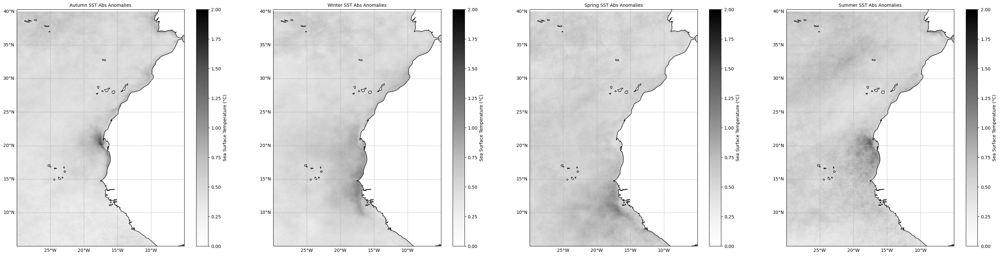

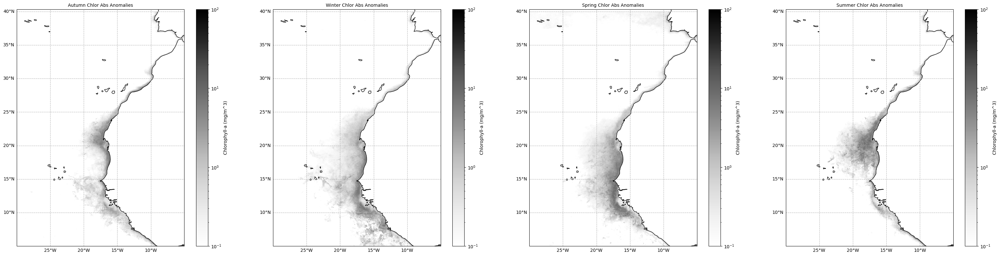

In [14]:
sst_anom_abs_seasonal_means = time_aggregator(ds_sst_anom_abs, 'sst', 'seasonal', 'mean')
plot_n_spatial_variable(
    [sst_anom_abs_seasonal_means['autumn'], sst_anom_abs_seasonal_means['winter'], sst_anom_abs_seasonal_means['spring'], sst_anom_abs_seasonal_means['summer']],
    ds_sst_raw.lat,
    ds_sst_raw.lon,
    nrows = 1,
    ncols = 4,
    i_width = 8,
    i_height = 8,
    clim=[0, 2], 
    titles = ['Autumn SST Abs Anomalies', 'Winter SST Abs Anomalies', 'Spring SST Abs Anomalies', 'Summer SST Abs Anomalies'],
    plot_label = 'Sea Surface Temperature (°C)',
    cmap = 'Greys',
    norm_mode = 'none'
)

chlor_anom_abs_seasonal_means = time_aggregator(ds_chlor_anom_abs, 'chlor_a', 'seasonal', 'mean')
plot_n_spatial_variable(
    [chlor_anom_abs_seasonal_means['autumn'], chlor_anom_abs_seasonal_means['winter'], chlor_anom_abs_seasonal_means['spring'], chlor_anom_abs_seasonal_means['summer']],
    ds_chlor_raw.lat,
    ds_chlor_raw.lon,
    nrows = 1,
    ncols = 4,
    i_width = 8,
    i_height = 8,
    clim=[0.1, 100],
    plot_label='Chlorophyll-a (mg/m^3)',
    cmap='Greys',
    norm_mode='log',
    titles = ['Autumn Chlor Abs Anomalies', 'Winter Chlor Abs Anomalies', 'Spring Chlor Abs Anomalies', 'Summer Chlor Abs Anomalies'],
)

#### Monthly Absolute Anomaly Means

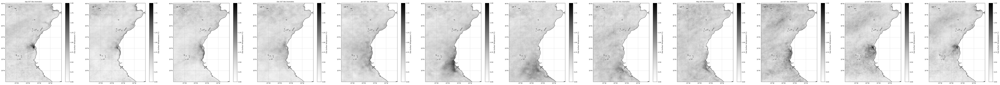

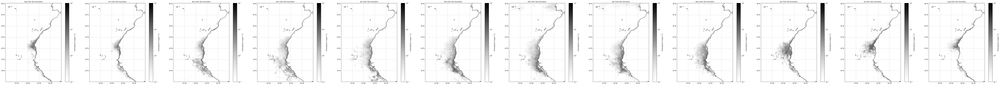

In [ ]:
sst_anom_abs_monthly_means = time_aggregator(ds_sst_anom_abs, 'sst', 'monthly', 'mean')
plot_n_spatial_variable(
    [
        sst_anom_abs_monthly_means[9], sst_anom_abs_monthly_means[10], sst_anom_abs_monthly_means[11], sst_anom_abs_monthly_means[12], sst_anom_abs_monthly_means[1], sst_anom_abs_monthly_means[2], 
        sst_anom_abs_monthly_means[3], sst_anom_abs_monthly_means[4], sst_anom_abs_monthly_means[5], sst_anom_abs_monthly_means[6], sst_anom_abs_monthly_means[7], sst_anom_abs_monthly_means[8]
    ],
    ds_sst_raw.lat,
    ds_sst_raw.lon,
    nrows = 1,
    ncols = 12,
    i_width = 8,
    i_height = 8,
    clim=[0, 2], 
    titles = [
        'Sep SST Abs Anomalies', 'Oct SST Abs Anomalies', 'Nov SST Abs Anomalies', 'Dec SST Abs Anomalies', 'Jan SST Abs Anomalies', 'Feb SST Abs Anomalies', 
        'Mar SST Abs Anomalies', 'Apr SST Abs Anomalies', 'May SST Abs Anomalies', 'Jun SST Abs Anomalies', 'Jul SST Abs Anomalies', 'Aug SST Abs Anomalies'
    ],
    plot_label = 'Sea Surface Temperature (°C)',
    cmap = 'Greys',
    norm_mode = 'none'
)

chlor_anom_abs_monthly_means = time_aggregator(ds_chlor_anom_abs, 'chlor_a', 'monthly', 'mean')
plot_n_spatial_variable(
    [
        chlor_anom_abs_monthly_means[9], chlor_anom_abs_monthly_means[10], chlor_anom_abs_monthly_means[11], chlor_anom_abs_monthly_means[12], chlor_anom_abs_monthly_means[1], chlor_anom_abs_monthly_means[2], 
        chlor_anom_abs_monthly_means[3], chlor_anom_abs_monthly_means[4], chlor_anom_abs_monthly_means[5], chlor_anom_abs_monthly_means[6], chlor_anom_abs_monthly_means[7], chlor_anom_abs_monthly_means[8]
    ],
    ds_chlor_raw.lat,
    ds_chlor_raw.lon,
    nrows = 1,
    ncols = 12,
    i_width = 8,
    i_height = 8,
    clim=[0.1, 100], 
    titles = [
        'Sep Chlor Abs Anomalies', 'Oct Chlor Abs Anomalies', 'Nov Chlor Abs Anomalies', 'Dec Chlor Abs Anomalies', 'Jan Chlor Abs Anomalies', 'Feb Chlor Abs Anomalies', 
        'Mar Chlor Abs Anomalies', 'Apr Chlor Abs Anomalies', 'May Chlor Abs Anomalies', 'Jun Chlor Abs Anomalies', 'Jul Chlor Abs Anomalies', 'Aug Chlor Abs Anomalies'
    ],
    plot_label = 'Chlorophyll-a (mg/m^3)',
    cmap = 'Greys',
    norm_mode = 'log'
)

#### Different Anomaly Standard Deviations

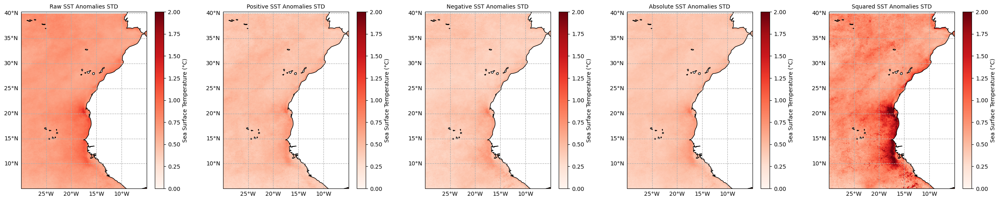

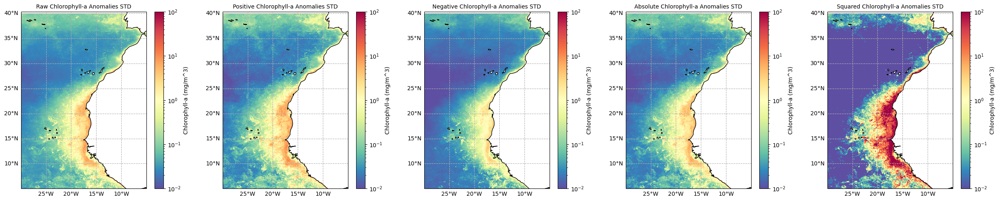

In [3]:
sst_anom_time_std = ds_sst_anom['sst'].std(axis=0)
sst_anom_pos_time_std = ds_sst_anom_pos['sst'].std(axis=0)
sst_anom_neg_time_std = ds_sst_anom_neg['sst'].std(axis=0)
sst_anom_abs_time_std = ds_sst_anom_abs['sst'].std(axis=0)
sst_anom_sqrd_time_std = ds_sst_anom_sqrd['sst'].std(axis=0)
plot_n_spatial_variable(
    target_list=[sst_anom_time_std, sst_anom_pos_time_std, sst_anom_neg_time_std, sst_anom_abs_time_std, sst_anom_sqrd_time_std],
    lat=ds_sst_raw['lat'],
    lon=ds_sst_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=5,
    clim=[0, 2], 
    cmap='Reds',
    plot_label='Sea Surface Temperature (°C)',
    titles=['Raw SST Anomalies STD', 'Positive SST Anomalies STD', 'Negative SST Anomalies STD', 'Absolute SST Anomalies STD', 'Squared SST Anomalies STD']
)

chlor_anom_time_std = ds_chlor_anom['chlor_a'].std(axis=0)
chlor_anom_pos_time_std = ds_chlor_anom_pos['chlor_a'].std(axis=0)
chlor_anom_neg_time_std = ds_chlor_anom_neg['chlor_a'].std(axis=0)
chlor_anom_abs_time_std = ds_chlor_anom_abs['chlor_a'].std(axis=0)
chlor_anom_sqrd_time_std = ds_chlor_anom_sqrd['chlor_a'].std(axis=0)
plot_n_spatial_variable(
    target_list=[chlor_anom_time_std, chlor_anom_pos_time_std, chlor_anom_neg_time_std, chlor_anom_abs_time_std, chlor_anom_sqrd_time_std],
    lat=ds_chlor_raw['lat'],
    lon=ds_chlor_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=5,
    clim=[0.01, 100],
    plot_label='Chlorophyll-a (mg/m^3)',
    cmap='Spectral_r',
    norm_mode='log',
    titles=['Raw Chlorophyll-a Anomalies STD', 'Positive Chlorophyll-a Anomalies STD', 'Negative Chlorophyll-a Anomalies STD', 'Absolute Chlorophyll-a Anomalies STD', 'Squared Chlorophyll-a Anomalies STD']
)

#### Total Anomaly Standard Deviations

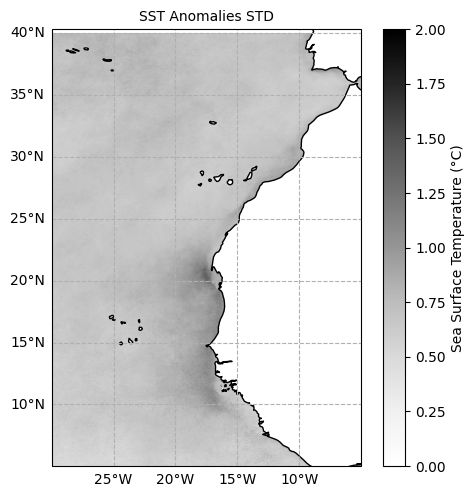

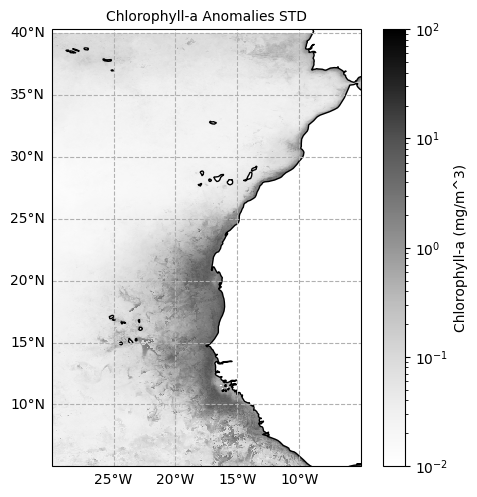

In [4]:
sst_anom_time_std = ds_sst_anom['sst'].std(axis=0)
plot_n_spatial_variable(
    target_list=[sst_anom_time_std],
    lat=ds_sst_raw['lat'],
    lon=ds_sst_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=5,
    clim=[0, 2], 
    cmap='Greys',
    plot_label='Sea Surface Temperature (°C)',
    titles=['SST Anomalies STD']
)

chlor_anom_time_std = ds_chlor_anom['chlor_a'].std(axis=0)
plot_n_spatial_variable(
    target_list=[chlor_anom_time_std],
    lat=ds_chlor_raw['lat'],
    lon=ds_chlor_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=5,
    clim=[0.01, 100],
    plot_label='Chlorophyll-a (mg/m^3)',
    cmap='Greys',
    norm_mode='log',
    titles=['Chlorophyll-a Anomalies STD']
)

#### Seasonal Anomaly Standard Deviations

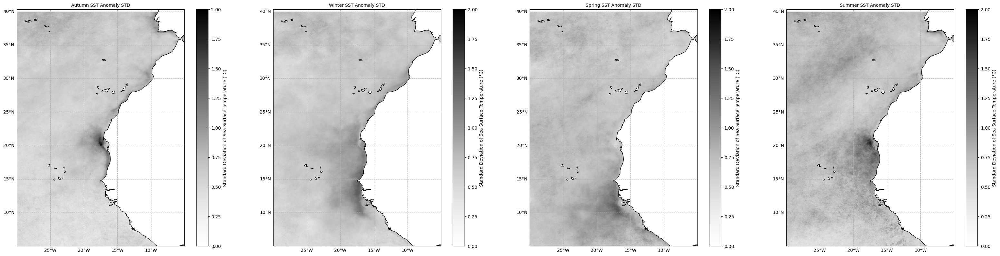

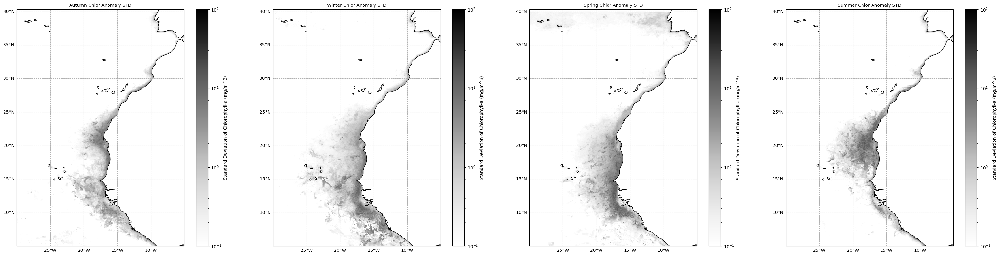

In [5]:
sst_anom_seasonal_stds = time_aggregator(ds_sst_anom, 'sst', 'seasonal', 'std')
plot_n_spatial_variable(
    [sst_anom_seasonal_stds['autumn'], sst_anom_seasonal_stds['winter'], sst_anom_seasonal_stds['spring'], sst_anom_seasonal_stds['summer']],
    ds_sst_raw.lat,
    ds_sst_raw.lon,
    nrows = 1,
    ncols = 4,
    i_width = 8,
    i_height = 8,
    clim=[0, 2], 
    titles = ['Autumn SST Anomaly STD', 'Winter SST Anomaly STD', 'Spring SST Anomaly STD', 'Summer SST Anomaly STD'],
    plot_label = 'Standard Deviation of Sea Surface Temperature (°C)', 
    cmap = 'Greys',
    norm_mode = 'none'
)

chlor_anom_seasonal_stds = time_aggregator(ds_chlor_anom, 'chlor_a', 'seasonal', 'std')
plot_n_spatial_variable(
    [chlor_anom_seasonal_stds['autumn'], chlor_anom_seasonal_stds['winter'], chlor_anom_seasonal_stds['spring'], chlor_anom_seasonal_stds['summer']],
    ds_chlor_raw.lat,
    ds_chlor_raw.lon,
    nrows = 1,
    ncols = 4,
    i_width = 8,
    i_height = 8,
    clim=[0.1, 100],
    plot_label='Standard Deviation of Chlorophyll-a (mg/m^3)',
    cmap='Greys',
    norm_mode='log',
    titles = ['Autumn Chlor Anomaly STD', 'Winter Chlor Anomaly STD', 'Spring Chlor Anomaly STD', 'Summer Chlor Anomaly STD'],
)

#### Monthly Anomaly Standard Deviations

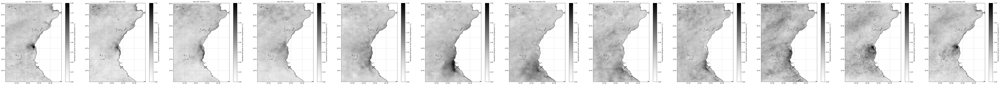

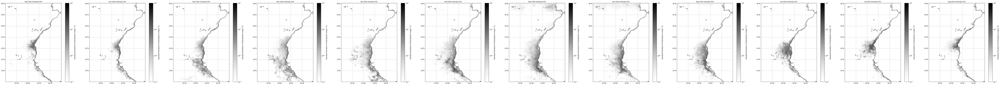

In [6]:
sst_anom_monthly_stds = time_aggregator(ds_sst_anom, 'sst', 'monthly', 'std')
plot_n_spatial_variable(
    [
        sst_anom_monthly_stds[9], sst_anom_monthly_stds[10], sst_anom_monthly_stds[11], sst_anom_monthly_stds[12], sst_anom_monthly_stds[1], sst_anom_monthly_stds[2], 
        sst_anom_monthly_stds[3], sst_anom_monthly_stds[4], sst_anom_monthly_stds[5], sst_anom_monthly_stds[6], sst_anom_monthly_stds[7], sst_anom_monthly_stds[8]
    ],
    ds_sst_raw.lat,
    ds_sst_raw.lon,
    nrows = 1,
    ncols = 12,
    i_width = 8,
    i_height = 8,
    clim=[0, 2], 
    titles = [
        'Sep SST Anomaly STD', 'Oct SST Anomaly STD', 'Nov SST Anomaly STD', 'Dec SST Anomaly STD', 'Jan SST Anomaly STD', 'Feb SST Anomaly STD', 
        'Mar SST Anomaly STD', 'Apr SST Anomaly STD', 'May SST Anomaly STD', 'Jun SST Anomaly STD', 'Jul SST Anomaly STD', 'Aug SST Anomaly STD'
    ],
    plot_label = 'Standard Deviation of Sea Surface Temperature (°C)', 
    cmap = 'Greys',
    norm_mode = 'none'
)

chlor_anom_monthly_stds = time_aggregator(ds_chlor_anom, 'chlor_a', 'monthly', 'std')
plot_n_spatial_variable(
    [
        chlor_anom_monthly_stds[9], chlor_anom_monthly_stds[10], chlor_anom_monthly_stds[11], chlor_anom_monthly_stds[12], chlor_anom_monthly_stds[1], chlor_anom_monthly_stds[2], 
        chlor_anom_monthly_stds[3], chlor_anom_monthly_stds[4], chlor_anom_monthly_stds[5], chlor_anom_monthly_stds[6], chlor_anom_monthly_stds[7], chlor_anom_monthly_stds[8]
    ],
    ds_chlor_raw.lat,
    ds_chlor_raw.lon,
    nrows = 1,
    ncols = 12,
    i_width = 8,
    i_height = 8,
    clim=[0.1, 100],
    plot_label='Standard Deviation of Chlorophyll-a (mg/m^3)',
    cmap='Greys',
    norm_mode='log',
    titles = [
        'Sep Chlor Anomaly STD', 'Oct Chlor Anomaly STD', 'Nov Chlor Anomaly STD', 'Dec Chlor Anomaly STD', 'Jan Chlor Anomaly STD', 'Feb Chlor Anomaly STD', 
        'Mar Chlor Anomaly STD', 'Apr Chlor Anomaly STD', 'May Chlor Anomaly STD', 'Jun Chlor Anomaly STD', 'Jul Chlor Anomaly STD', 'Aug Chlor Anomaly STD'
    ]
)

### Upwelling Focus - Negative SST Anomaly + Positive Chlor Anomaly

#### Total

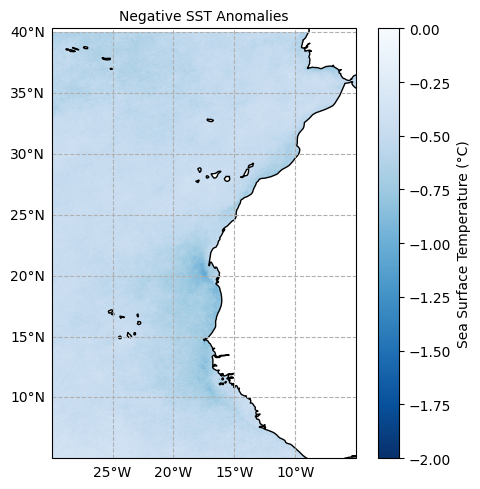

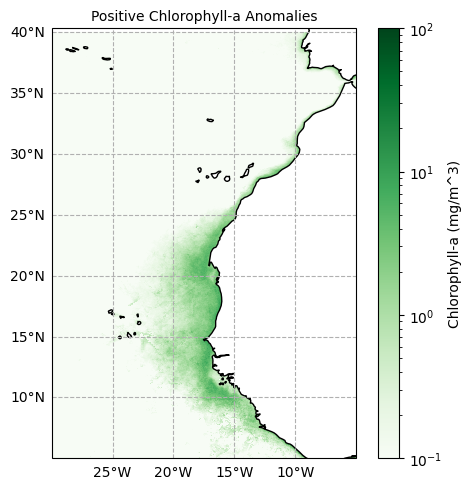

In [11]:
sst_anom_neg_time_mean = ds_sst_anom_neg['sst'].mean(axis=0)
plot_n_spatial_variable(
    target_list=[sst_anom_neg_time_mean],
    lat=ds_sst_raw['lat'],
    lon=ds_sst_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=1,
    clim=[-2, 0], 
    cmap='Blues_r',
    plot_label='Sea Surface Temperature (°C)',
    titles=['Negative SST Anomalies']
)

chlor_anom_pos_time_mean = ds_chlor_anom_pos['chlor_a'].mean(axis=0)
plot_n_spatial_variable(
    target_list=[chlor_anom_pos_time_mean],
    lat=ds_chlor_raw['lat'],
    lon=ds_chlor_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=1,
    clim=[0.1, 100],
    plot_label='Chlorophyll-a (mg/m^3)',
    cmap='Greens',
    norm_mode='log',
    titles=['Positive Chlorophyll-a Anomalies']
)

#### Seasonal

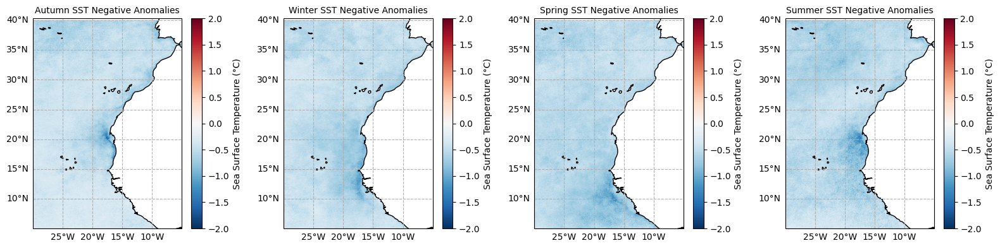

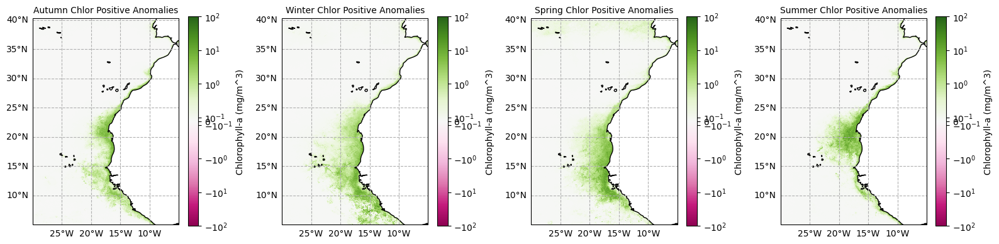

In [8]:
sst_neg_anom_seasonal_means = time_aggregator(ds_sst_anom_neg, 'sst', 'seasonal', 'mean')
plot_n_spatial_variable(
    [
        sst_neg_anom_seasonal_means['autumn'], sst_neg_anom_seasonal_means['winter'], sst_neg_anom_seasonal_means['spring'], sst_neg_anom_seasonal_means['summer']
    ],
    ds_sst_raw.lat,
    ds_sst_raw.lon,
    nrows = 1,
    ncols = 4,
    i_width = 4,
    i_height = 4,
    clim=[-2, 2], 
    titles = [
        'Autumn SST Negative Anomalies', 'Winter SST Negative Anomalies', 'Spring SST Negative Anomalies', 'Summer SST Negative Anomalies'
    ],
    plot_label = 'Sea Surface Temperature (°C)',
    cmap = 'RdBu_r',
    norm_mode = 'none'
)

chlor_pos_anom_seasonal_means = time_aggregator(ds_chlor_anom_pos, 'chlor_a', 'seasonal', 'mean')
plot_n_spatial_variable(
    [
        chlor_pos_anom_seasonal_means['autumn'], chlor_pos_anom_seasonal_means['winter'], chlor_pos_anom_seasonal_means['spring'], chlor_pos_anom_seasonal_means['summer']
    ],
    ds_chlor_raw.lat,
    ds_chlor_raw.lon,
    nrows = 1,
    ncols = 4,
    i_width = 4,
    i_height = 4,
    clim=[-100, 100],
    plot_label='Chlorophyll-a (mg/m^3)',
    cmap='PiYG',
    norm_mode='symlog',
    titles = [
        'Autumn Chlor Positive Anomalies', 'Winter Chlor Positive Anomalies', 'Spring Chlor Positive Anomalies', 'Summer Chlor Positive Anomalies'
    ],
)

#### Monthly

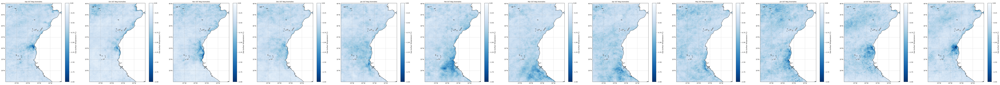

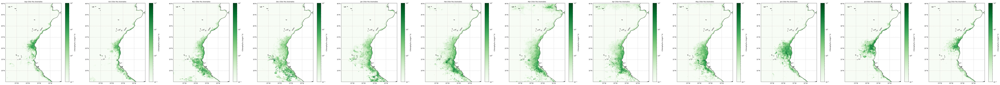

In [9]:
sst_anom_neg_monthly_means = time_aggregator(ds_sst_anom_neg, 'sst', 'monthly', 'mean')
plot_n_spatial_variable(
    [
        sst_anom_neg_monthly_means[9], sst_anom_neg_monthly_means[10], sst_anom_neg_monthly_means[11], sst_anom_neg_monthly_means[12], sst_anom_neg_monthly_means[1], sst_anom_neg_monthly_means[2], 
        sst_anom_neg_monthly_means[3], sst_anom_neg_monthly_means[4], sst_anom_neg_monthly_means[5], sst_anom_neg_monthly_means[6], sst_anom_neg_monthly_means[7], sst_anom_neg_monthly_means[8]
    ],
    ds_sst_raw.lat,
    ds_sst_raw.lon,
    nrows = 1,
    ncols = 12,
    i_width = 8,
    i_height = 8,
    clim=[-2, 0], 
    titles = [
        'Sep SST Neg Anomalies', 'Oct SST Neg Anomalies', 'Nov SST Neg Anomalies', 'Dec SST Neg Anomalies', 'Jan SST Neg Anomalies', 'Feb SST Neg Anomalies', 
        'Mar SST Neg Anomalies', 'Apr SST Neg Anomalies', 'May SST Neg Anomalies', 'Jun SST Neg Anomalies', 'Jul SST Neg Anomalies', 'Aug SST Neg Anomalies'
    ],
    plot_label = 'Sea Surface Temperature (°C)',
    cmap = 'Blues_r',
    norm_mode = 'none'
)

chlor_anom_pos_monthly_means = time_aggregator(ds_chlor_anom_pos, 'chlor_a', 'monthly', 'mean')
plot_n_spatial_variable(
    [
        chlor_anom_pos_monthly_means[9], chlor_anom_pos_monthly_means[10], chlor_anom_pos_monthly_means[11], chlor_anom_pos_monthly_means[12], chlor_anom_pos_monthly_means[1], chlor_anom_pos_monthly_means[2], 
        chlor_anom_pos_monthly_means[3], chlor_anom_pos_monthly_means[4], chlor_anom_pos_monthly_means[5], chlor_anom_pos_monthly_means[6], chlor_anom_pos_monthly_means[7], chlor_anom_pos_monthly_means[8]
    ],
    ds_chlor_raw.lat,
    ds_chlor_raw.lon,
    nrows = 1,
    ncols = 12,
    i_width = 8,
    i_height = 8,
    clim=[0.1, 100], 
    titles = [
        'Sep Chlor Pos Anomalies', 'Oct Chlor Pos Anomalies', 'Nov Chlor Pos Anomalies', 'Dec Chlor Pos Anomalies', 'Jan Chlor Pos Anomalies', 'Feb Chlor Pos Anomalies', 
        'Mar Chlor Pos Anomalies', 'Apr Chlor Pos Anomalies', 'May Chlor Pos Anomalies', 'Jun Chlor Pos Anomalies', 'Jul Chlor Pos Anomalies', 'Aug Chlor Pos Anomalies'
    ],
    plot_label = 'Chlorophyll-a (mg/m^3)',
    cmap = 'Greens',
    norm_mode = 'log'
)

### General - SST & Chlor Anomaly Means and STDs

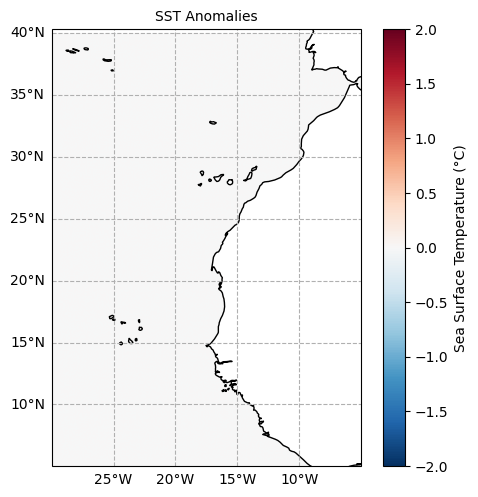

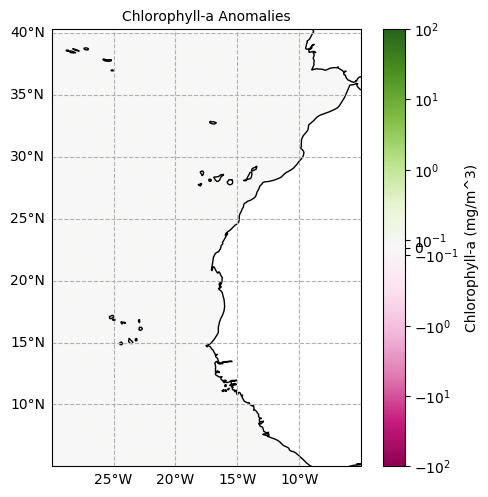

In [7]:
sst_anom_time_mean = ds_sst_anom['sst'].mean(axis=0)
plot_n_spatial_variable(
    target_list=[sst_anom_time_mean],
    lat=ds_sst_raw['lat'],
    lon=ds_sst_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=5,
    clim=[-2, 2], 
    cmap='RdBu_r',
    plot_label='Sea Surface Temperature (°C)',
    titles=['SST Anomalies']
)

chlor_anom_time_mean = ds_chlor_anom['chlor_a'].mean(axis=0)
plot_n_spatial_variable(
    target_list=[chlor_anom_time_mean],
    lat=ds_chlor_raw['lat'],
    lon=ds_chlor_raw['lon'],
    i_width=5,
    i_height=5,
    nrows=1,
    ncols=5,
    clim=[-100, 100],
    plot_label='Chlorophyll-a (mg/m^3)',
    cmap='PiYG',
    norm_mode='symlog',
    titles=['Chlorophyll-a Anomalies']
)